# Setup

In [2]:
import scrnatools as rna
import scvi
import seaborn as sns
import warnings
import matplotlib.pyplot as plt
import scanpy as sc

In [3]:
sc.set_figure_params(figsize=(4,4),  dpi=150, dpi_save=300, facecolor="white", frameon=False)
plt.rcParams["axes.grid"] = False
sns.set_context("paper")
warnings.simplefilter(action='ignore', category=FutureWarning)

# Data paths

## demeter

In [4]:
rawDataPath = "/mnt/iacchus/joe/raw_data/"
processedDataPath = "/mnt/iacchus/joe/processed_data/"

## gardner-lab-computer

In [5]:
# rawDataPath = "/mnt/e/Archive/Joe/raw_data/"
# processedDataPath = "/mnt/e/Archive/Joe/processed_data/"

# Import data

In [8]:
adata = sc.read(f"{processedDataPath}/M_cell/h5ad_files/combined_WT_fezf2KO_aireKO_all_genes.h5ad")

In [9]:
adata.obs

,batch,genotype,experiment,scrublet_score,scrublet_called_doublet,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,n_genes,_scvi_batch,_scvi_labels,leiden_scVI,cell_type
AAACCCACAAGACCGA-1,WT_1,WT,1,0.049366,False,2433,5768.0,292.0,5.062413,2433,0,0,1,Late Aire
AAACCCACAAGATTGA-1,WT_1,WT,1,0.084044,False,3993,15077.0,659.0,4.370896,3993,0,0,4,Tuft
AAACCCACACGACGAA-1,WT_1,WT,1,0.036385,False,2988,9076.0,229.0,2.523138,2988,0,0,2,Ccl21a+
AAACCCACACTGAATC-1,WT_1,WT,1,0.121778,False,4392,16851.0,735.0,4.361759,4392,0,0,0,Aire+
AAACCCATCCAAGCCG-1,WT_1,WT,1,0.105536,False,5239,27691.0,1029.0,3.716009,5239,0,0,0,Aire+
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGAGCTCCCTT-1,WT_3,WT,3,0.056188,False,3813,18820.0,356.0,1.891605,3813,4,0,1,Late Aire
TTTGTTGCACTTGACA-1,WT_3,WT,3,0.061150,False,4151,17350.0,420.0,2.420749,4151,4,0,1,Late Aire
TTTGTTGCATTCCTAT-1,WT_3,WT,3,0.077549,False,3137,10763.0,243.0,2.257735,3137,4,0,1,Late Aire
TTTGTTGGTCTGTTAG-1,WT_3,WT,3,0.080010,False,2321,12502.0,675.0,5.399136,2321,4,0,0,Aire+


/conda-global-envs/single-cell-analysis/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


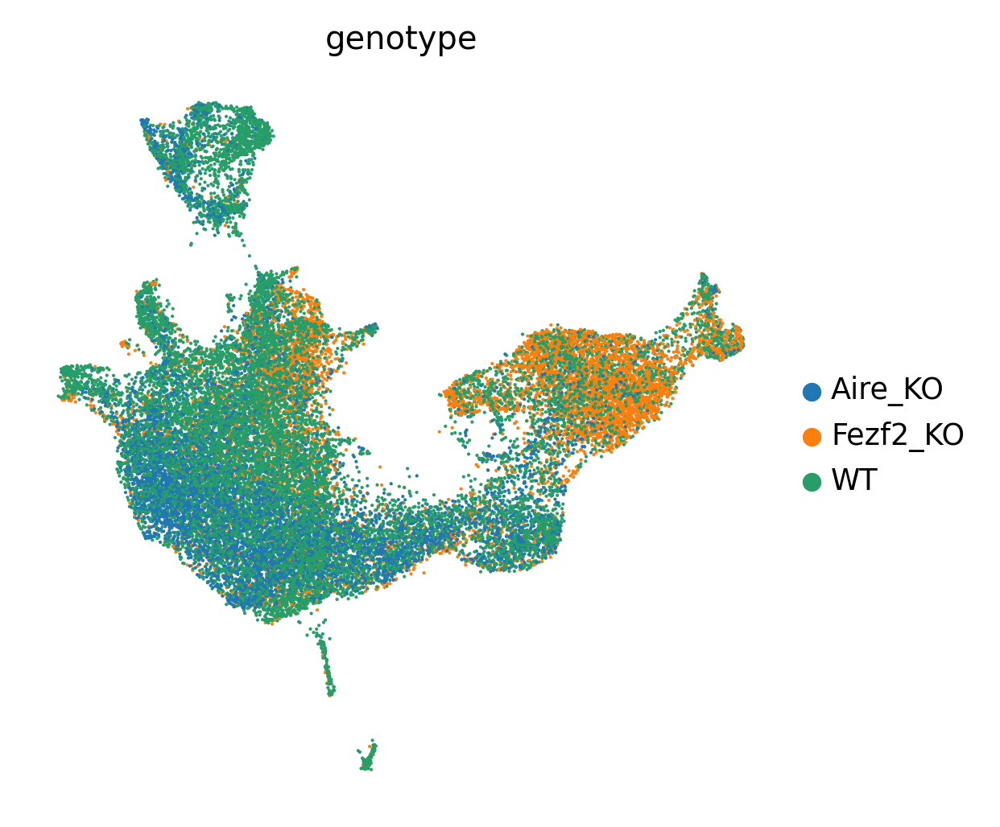

In [14]:
sc.pl.umap(
    adata,
    color=["genotype"]
)

In [33]:
# Subset on Ccl21a+ WT cells
adataSubset = adata[(adata.obs.cell_type == "Ccl21a+") & (adata.obs.genotype == "WT")].copy()

/conda-global-envs/single-cell-analysis/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


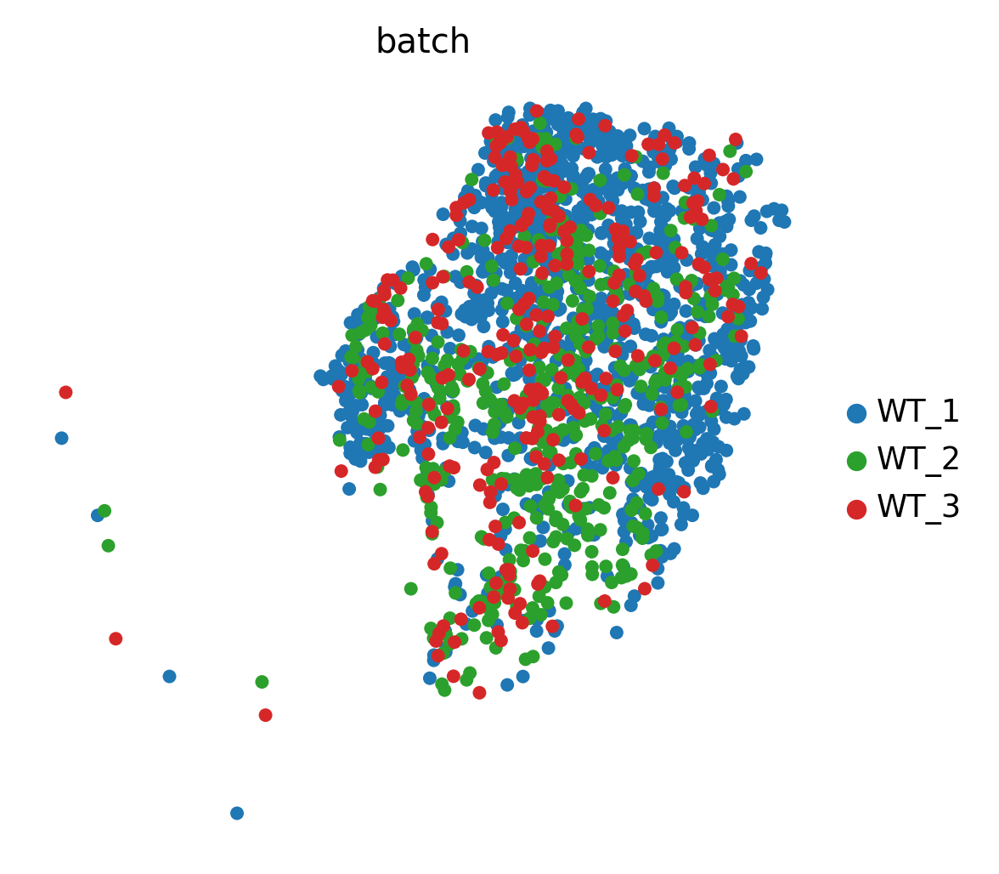

In [34]:
sc.pl.umap(
    adataSubset,
    color=["batch"]
)

In [35]:
sc.pp.neighbors(adataSubset, use_rep="X_scVI")
sc.tl.umap(adataSubset, min_dist=0.25,)

/conda-global-envs/single-cell-analysis/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/conda-global-envs/single-cell-analysis/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


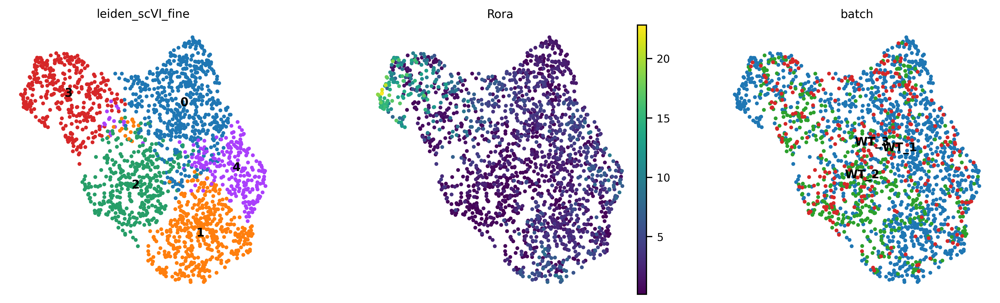

In [37]:
sc.tl.leiden(adataSubset, key_added="leiden_scVI_fine", resolution=0.48)
sc.pl.umap(
    adataSubset,
    color=["leiden_scVI_fine", "Rora", "batch"],
    legend_loc="on data",
    layer="scVI_normalized",
    s=40,
)

In [39]:
de_df = model.differential_expression(
    adata=adataSubset,
    groupby="leiden_scVI_fine",
    group1="3"
)

DE...: 100%|██████████| 1/1 [00:03<00:00,  3.96s/it]


In [40]:
de_df

,proba_de,proba_not_de,bayes_factor,scale1,scale2,pseudocounts,delta,lfc_mean,lfc_median,lfc_std,...,raw_mean1,raw_mean2,non_zeros_proportion1,non_zeros_proportion2,raw_normalized_mean1,raw_normalized_mean2,is_de_fdr_0.05,comparison,group1,group2
Cox6c,0.9906,0.0094,4.657600,2.124715e-04,8.755589e-04,0.0,0.25,-2.309033,-2.196923,1.083874,...,1.783932,10.007762,0.653740,0.996443,1.950079,9.035023,True,3 vs Rest,3,Rest
Ndufa7,0.9890,0.0110,4.498798,6.383728e-05,2.892932e-04,0.0,0.25,-2.430322,-2.392748,1.093198,...,0.554017,3.208690,0.351801,0.917605,0.620658,2.887396,True,3 vs Rest,3,Rest
Atp5l,0.9888,0.0112,4.480577,1.441701e-04,5.167420e-04,0.0,0.25,-2.063511,-1.944255,0.974521,...,1.249307,6.091920,0.570637,0.982810,1.367511,5.400263,True,3 vs Rest,3,Rest
Spp2,0.9876,0.0124,4.377580,6.054332e-09,4.561916e-07,0.0,0.25,-5.305933,-5.218269,3.092968,...,0.000000,0.000593,0.000000,0.000593,0.000000,0.000595,True,3 vs Rest,3,Rest
Gm11789,0.9870,0.0130,4.329720,2.481450e-08,7.661398e-07,0.0,0.25,-4.968549,-4.772182,3.066201,...,0.000000,0.001778,0.000000,0.001778,0.000000,0.001951,True,3 vs Rest,3,Rest
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Pcbp2,0.6492,0.3508,0.615525,2.738760e-04,2.663667e-04,0.0,0.25,0.004248,0.048600,0.584246,...,2.404431,3.236545,0.864266,0.902193,2.921159,2.809166,False,3 vs Rest,3,Rest
Ctnnb1,0.6436,0.3564,0.591024,1.610555e-04,1.600363e-04,0.0,0.25,-0.011612,-0.008756,0.598369,...,1.362880,1.767062,0.662050,0.773563,1.666364,1.597781,False,3 vs Rest,3,Rest
Ralbp1,0.6368,0.3632,0.561502,2.307852e-04,2.342788e-04,0.0,0.25,-0.042278,-0.005852,0.600556,...,1.955676,2.620065,0.772853,0.850622,2.431626,2.356359,False,3 vs Rest,3,Rest
Top1,0.6040,0.3960,0.422160,3.461746e-04,3.616307e-04,0.0,0.25,-0.104124,-0.053014,0.571526,...,2.900278,4.117995,0.861496,0.935388,3.596541,3.647138,False,3 vs Rest,3,Rest


In [64]:
filtered_de = de_df[de_df.bayes_factor > 2.5]
filtered_de = filtered_de[filtered_de.lfc_mean > 0]
filtered_de = filtered_de[filtered_de.non_zeros_proportion1 > 0.05]
filtered_de = filtered_de.sort_values(by="lfc_mean", ascending=False)

In [65]:
filtered_de.loc["Rora"]

proba_de                     0.949
proba_not_de                 0.051
bayes_factor              2.923583
scale1                    0.000681
scale2                    0.000273
pseudocounts                   0.0
delta                         0.25
lfc_mean                  1.004879
lfc_median                1.104209
lfc_std                   2.390851
lfc_min                  -4.795387
lfc_max                   6.965346
raw_mean1                 5.049858
raw_mean2                 2.815072
non_zeros_proportion1     0.714681
non_zeros_proportion2     0.673385
raw_normalized_mean1      7.002617
raw_normalized_mean2      2.601059
is_de_fdr_0.05                True
comparison               3 vs Rest
group1                           3
group2                        Rest
Name: Rora, dtype: object

In [73]:
filtered_de[filtered_de["is_de_fdr_0.05"]].head(50)

,proba_de,proba_not_de,bayes_factor,scale1,scale2,pseudocounts,delta,lfc_mean,lfc_median,lfc_std,...,raw_mean1,raw_mean2,non_zeros_proportion1,non_zeros_proportion2,raw_normalized_mean1,raw_normalized_mean2,is_de_fdr_0.05,comparison,group1,group2
Kif11,0.9634,0.0366,3.270420,0.000048,0.000004,0.0,0.25,3.325488,3.254571,3.303748,...,0.177285,0.010670,0.060942,0.010670,0.169996,0.008441,True,3 vs Rest,3,Rest
Plat,0.9638,0.0362,3.281824,0.000199,0.000019,0.0,0.25,3.093761,3.207240,2.861410,...,0.216066,0.093657,0.088643,0.065205,0.191731,0.076692,True,3 vs Rest,3,Rest
Gm47547,0.9636,0.0364,3.276107,0.000079,0.000008,0.0,0.25,3.046780,3.049451,2.363948,...,0.088643,0.062241,0.069252,0.055127,0.103397,0.052493,True,3 vs Rest,3,Rest
Ckap2,0.9568,0.0432,3.097754,0.000184,0.000018,0.0,0.25,2.730125,2.806199,3.232618,...,0.144044,0.040308,0.066482,0.036752,0.160790,0.030355,True,3 vs Rest,3,Rest
Tpx2,0.9490,0.0510,2.923583,0.000038,0.000005,0.0,0.25,2.537477,2.555420,2.485799,...,0.113573,0.036159,0.072022,0.032009,0.099892,0.028169,True,3 vs Rest,3,Rest
Nusap1,0.9514,0.0486,2.974311,0.000110,0.000013,0.0,0.25,2.467729,2.424683,2.618247,...,0.135734,0.032009,0.069252,0.028453,0.154202,0.026637,True,3 vs Rest,3,Rest
Card14,0.9542,0.0458,3.036589,0.000055,0.000013,0.0,0.25,2.423982,2.420284,2.750155,...,0.088643,0.048014,0.058172,0.037937,0.123677,0.041387,True,3 vs Rest,3,Rest
Cftr,0.9520,0.0480,2.987364,0.000104,0.000021,0.0,0.25,2.408650,2.363745,2.406647,...,0.163435,0.086544,0.088643,0.063426,0.234482,0.074476,True,3 vs Rest,3,Rest
Tacr1,0.9508,0.0492,2.961410,0.000063,0.000011,0.0,0.25,2.329165,2.296317,2.271623,...,0.180055,0.088322,0.110803,0.068761,0.217349,0.081051,True,3 vs Rest,3,Rest
Zfhx4,0.9526,0.0474,3.000573,0.000044,0.000009,0.0,0.25,2.320958,2.283911,2.469897,...,0.110803,0.059870,0.055402,0.043865,0.122100,0.050863,True,3 vs Rest,3,Rest


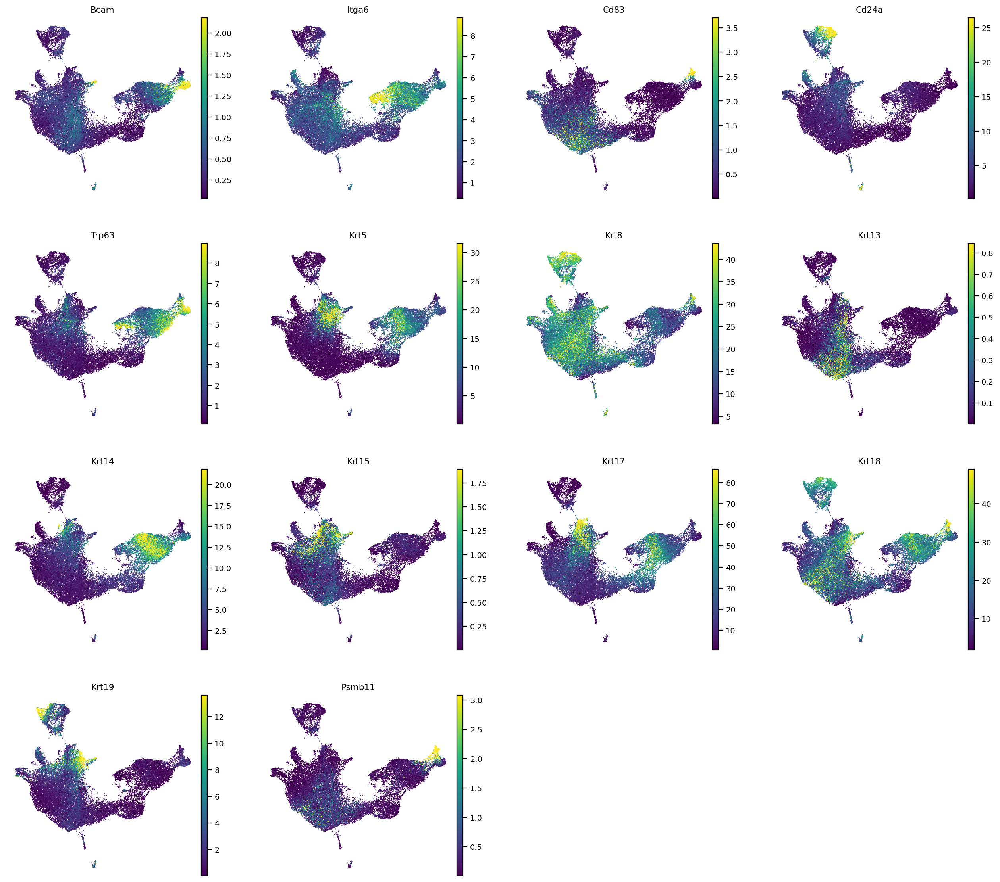

In [67]:
rna.pl.gene_embedding(
    adata,
    gene_list=["Bcam", "Itga6", "Cd83", "Cd24a", "Trp63", "Krt5", "Krt8", "Krt13", "Krt14", "Krt15", "Krt17", "Krt18", "Krt19", "Psmb11"],
    layer="scVI_normalized",
)

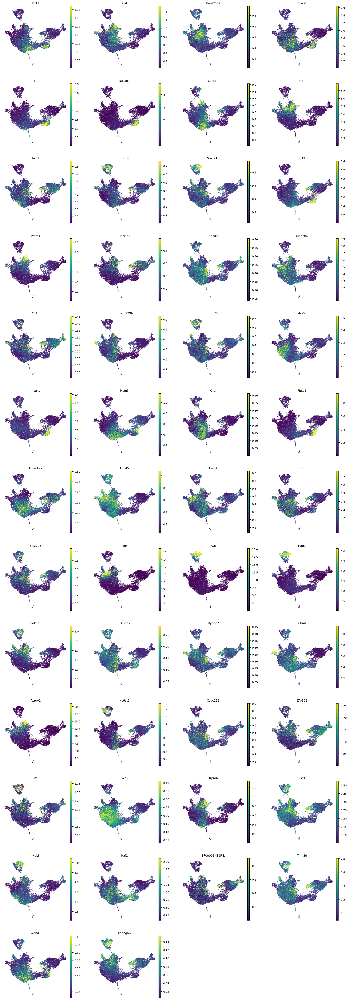

In [74]:
rna.pl.gene_embedding(
    adata,
    gene_list=filtered_de[filtered_de["is_de_fdr_0.05"]].head(50).index,
    layer="scVI_normalized",
)

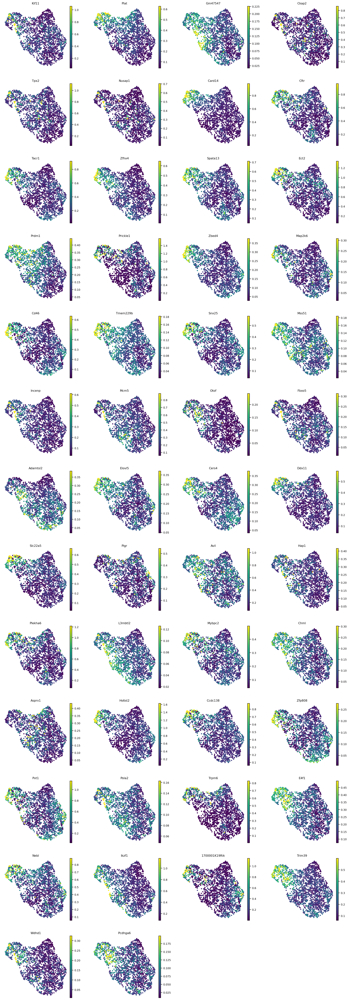

In [75]:
rna.pl.gene_embedding(
    adataSubset,
    gene_list=filtered_de[filtered_de["is_de_fdr_0.05"]].head(50).index,
    layer="scVI_normalized",
)

In [70]:
filtered_de.to_csv("analysis/ccl21a_nub_de_genes.csv")

In [76]:
adata.obs["leiden_scVI_fine"] = adataSubset.obs.leiden_scVI_fine

In [81]:
de_df = model.differential_expression(
    adata=adata[adata.obs.genotype == "WT"],
    groupby="leiden_scVI_fine",
    group1="3"
)

INFO     Received view of anndata, making copy.                                                                    
INFO     Input AnnData not setup with scvi-tools. attempting to transfer AnnData setup                             
DE...: 100%|██████████| 1/1 [00:06<00:00,  6.43s/it]


In [84]:
filtered_de = de_df[de_df.bayes_factor > 3]
filtered_de = filtered_de[filtered_de.lfc_mean > 0]
filtered_de = filtered_de[filtered_de.non_zeros_proportion1 > 0.1]
filtered_de = filtered_de.sort_values(by="lfc_mean", ascending=False)

In [87]:
filtered_de.head(50)

,proba_de,proba_not_de,bayes_factor,scale1,scale2,pseudocounts,delta,lfc_mean,lfc_median,lfc_std,...,raw_mean1,raw_mean2,non_zeros_proportion1,non_zeros_proportion2,raw_normalized_mean1,raw_normalized_mean2,is_de_fdr_0.05,comparison,group1,group2
Ntrk3,0.9844,0.0156,4.144761,0.000104,0.000007,0.0,0.25,6.276452,6.636273,3.965381,...,0.310249,0.110880,0.138504,0.041076,0.467429,0.081804,True,3 vs Rest,3,Rest
Gpc5,0.9780,0.0220,3.794467,0.000117,0.000013,0.0,0.25,5.032858,5.289447,4.269574,...,0.462604,0.250061,0.141274,0.062347,0.680307,0.181413,True,3 vs Rest,3,Rest
Sntb1,0.9814,0.0186,3.965818,0.000104,0.000012,0.0,0.25,4.837934,5.039961,2.991726,...,0.368421,0.593971,0.174515,0.223655,0.550421,0.394731,True,3 vs Rest,3,Rest
Trpv3,0.9808,0.0192,3.933458,0.000019,0.000003,0.0,0.25,4.604988,4.776433,3.162122,...,0.116343,0.036919,0.102493,0.029645,0.155560,0.025704,True,3 vs Rest,3,Rest
Ifnlr1,0.9802,0.0198,3.902074,0.000059,0.000004,0.0,0.25,4.481626,4.596081,2.580301,...,0.180055,0.034658,0.135734,0.029951,0.248627,0.027129,True,3 vs Rest,3,Rest
Kirrel,0.9814,0.0186,3.965818,0.000056,0.000007,0.0,0.25,4.414679,4.536462,3.235358,...,0.396122,0.063142,0.285319,0.048594,0.571460,0.051464,True,3 vs Rest,3,Rest
Robo2,0.9822,0.0178,4.010596,0.000502,0.000048,0.0,0.25,4.223775,4.451573,2.653427,...,4.465371,1.228752,0.662050,0.319988,6.208704,0.879303,True,3 vs Rest,3,Rest
Als2,0.9774,0.0226,3.766946,0.000027,0.000003,0.0,0.25,4.082812,4.173199,2.550096,...,0.166205,0.157090,0.132964,0.118643,0.224325,0.101356,True,3 vs Rest,3,Rest
Gpr176,0.9706,0.0294,3.496919,0.000086,0.000010,0.0,0.25,4.075689,4.215692,3.341191,...,0.324100,0.077689,0.168975,0.049450,0.431259,0.053964,True,3 vs Rest,3,Rest
Zcchc24,0.9716,0.0284,3.532555,0.000025,0.000004,0.0,0.25,4.012250,4.141379,2.763867,...,0.191136,0.061430,0.163435,0.042115,0.269917,0.045009,True,3 vs Rest,3,Rest


In [90]:
filtered_de.head(50)

,proba_de,proba_not_de,bayes_factor,scale1,scale2,pseudocounts,delta,lfc_mean,lfc_median,lfc_std,...,raw_mean1,raw_mean2,non_zeros_proportion1,non_zeros_proportion2,raw_normalized_mean1,raw_normalized_mean2,is_de_fdr_0.05,comparison,group1,group2
Ntrk3,0.9844,0.0156,4.144761,0.000104,0.000007,0.0,0.25,6.276452,6.636273,3.965381,...,0.310249,0.110880,0.138504,0.041076,0.467429,0.081804,True,3 vs Rest,3,Rest
Gpc5,0.9780,0.0220,3.794467,0.000117,0.000013,0.0,0.25,5.032858,5.289447,4.269574,...,0.462604,0.250061,0.141274,0.062347,0.680307,0.181413,True,3 vs Rest,3,Rest
Sntb1,0.9814,0.0186,3.965818,0.000104,0.000012,0.0,0.25,4.837934,5.039961,2.991726,...,0.368421,0.593971,0.174515,0.223655,0.550421,0.394731,True,3 vs Rest,3,Rest
Trpv3,0.9808,0.0192,3.933458,0.000019,0.000003,0.0,0.25,4.604988,4.776433,3.162122,...,0.116343,0.036919,0.102493,0.029645,0.155560,0.025704,True,3 vs Rest,3,Rest
Ifnlr1,0.9802,0.0198,3.902074,0.000059,0.000004,0.0,0.25,4.481626,4.596081,2.580301,...,0.180055,0.034658,0.135734,0.029951,0.248627,0.027129,True,3 vs Rest,3,Rest
Kirrel,0.9814,0.0186,3.965818,0.000056,0.000007,0.0,0.25,4.414679,4.536462,3.235358,...,0.396122,0.063142,0.285319,0.048594,0.571460,0.051464,True,3 vs Rest,3,Rest
Robo2,0.9822,0.0178,4.010596,0.000502,0.000048,0.0,0.25,4.223775,4.451573,2.653427,...,4.465371,1.228752,0.662050,0.319988,6.208704,0.879303,True,3 vs Rest,3,Rest
Als2,0.9774,0.0226,3.766946,0.000027,0.000003,0.0,0.25,4.082812,4.173199,2.550096,...,0.166205,0.157090,0.132964,0.118643,0.224325,0.101356,True,3 vs Rest,3,Rest
Gpr176,0.9706,0.0294,3.496919,0.000086,0.000010,0.0,0.25,4.075689,4.215692,3.341191,...,0.324100,0.077689,0.168975,0.049450,0.431259,0.053964,True,3 vs Rest,3,Rest
Zcchc24,0.9716,0.0284,3.532555,0.000025,0.000004,0.0,0.25,4.012250,4.141379,2.763867,...,0.191136,0.061430,0.163435,0.042115,0.269917,0.045009,True,3 vs Rest,3,Rest


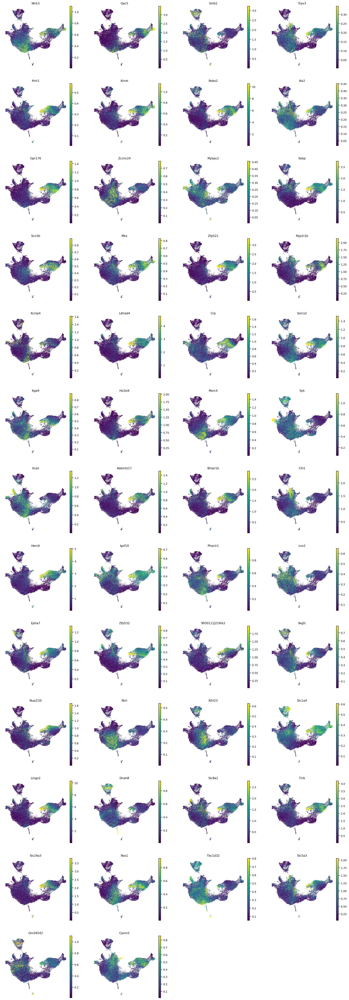

In [86]:
rna.pl.gene_embedding(
    adata,
    gene_list=filtered_de[filtered_de["is_de_fdr_0.05"]].head(50).index,
    layer="scVI_normalized",
)

In [91]:
filtered_de.to_csv("analysis/ccl21a_nub_specific_genes.csv")